In [16]:
import cv2
import matplotlib.pyplot as plt 
import math
from matplotlib.path import Path
from matplotlib.lines import Line2D
import numpy as np
from math import sqrt
from sklearn.neighbors import NearestNeighbors as NN
import pandas as pd
from sklearn.cluster import OPTICS

### Определение всех особых точек

In [2]:
import imutils
def detect_fingers_final(image, title='default', bad_pict=False):
    #fig = plt.figure()
    #ax = plt.subplot()
    point_finger = []
    point_between = []

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    _, thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)
    thresh = cv2.erode(thresh, None, iterations=2) # убираем шумы с помощью эрозии и дилатации после бинаризации изображения
    thresh = cv2.dilate(thresh, None, iterations=2)

    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts) # ищем контуры

    hand = max(cnts, key=cv2.contourArea) #выбираем контур, соответствующий ладони, т.е. максимальный по площади

    x,y,w,h = cv2.boundingRect(hand) # строим вокруг руки прямоугольник и ищем по нему средний цвет

    pixels= 1.0 * image[y:y + h, x:x + w].shape[0] * image[y:y + h,x:x + w].shape[1]
    channel_1 = np.sum(image[y:y + h, x:x + w][:,:,0]) / pixels
    channel_2 = np.sum(image[y:y + h,x:x + w][:,:,1]) / pixels
    channel_3 = np.sum(image[y:y + h,x:x + w][:,:,2]) / pixels

    av_color = np.mean(np.array([channel_1,channel_2,channel_3]).astype(np.uint8))
    
    sq = cv2.contourArea(hand) #площадь ладони
    perimeter = cv2.arcLength(hand,True) #периметр ладони

    n = hand.copy()

    epsilon = 0.0005 * cv2.arcLength(n,True) # параметр для approx

    approx= cv2.approxPolyDP(n,epsilon,True) #строим прямоугольник с учетом особнностей формы

    hull = cv2.convexHull(n) # строим выпуклую оболочку
    
    hull = cv2.convexHull(approx, returnPoints=True) # возвращаем точки, чтобы нарисовать
    cv2.drawContours(image, [hull], -1, (0, 255, 255), 2)
    
    hull_1 = cv2.convexHull(approx, returnPoints=False)
    defects = cv2.convexityDefects(approx, hull_1) #defects, which are the local maximum deviations of hull from contours
    l = 0
    start_arr = []
    end_arr = []
    far_arr = []
    rest = []
    fingers = []
    for i in range(defects.shape[0]): #смотрим по всем дефектам (лок максимумам)
        s,e,f,d = defects[i,0]
        start = tuple(approx[s][0])
        end = tuple(approx[e][0])
        far = tuple(approx[f][0])

        a = math.sqrt((end[0] - start[0])**2 + (end[1] - start[1])**2)
        b = math.sqrt((far[0] - start[0])**2 + (far[1] - start[1])**2)
        c = math.sqrt((end[0] - far[0])**2 + (end[1] - far[1])**2)
        p_p = (a + b + c) / 2
        ar = math.sqrt(p_p * (p_p - a) * (p_p - b) * (p_p - c))

        d = (2 * ar) / a #расстояние между точкой и выпуклой оболочкой (теорема синусов)
        porog = 87
        
        if bad_pict:
            porog = 100
        
        angle = math.acos((b**2 + c**2 - a**2) / (2 * b * c)) * 57 #теорема косинусов
        if l < 4:
            if angle <= porog and d > 30:
                l += 1
                if l == 1:
                    cv2.circle(image, far, 8, [255,0,0], -1)
                    cv2.circle(image, start, 8, [255,0,0], -1)
                    col = 'red'
                elif l == 2:
                    cv2.circle(image, far, 8, [255,255,0], -1)
                    cv2.circle(image, start, 8, [255,255,0], -1)
                    col = 'yellow'

                elif l == 3:
                    cv2.circle(image, far, 8, [0,255,0], -1)
                    cv2.circle(image, start, 8, [0,255,0], -1)
                    col = 'green'

                elif l == 4:
                    cv2.circle(image, far, 8, [0,0,255], -1)
                    cv2.circle(image, start, 8, [0,0,255], -1)
                    col = 'blue'

                point_between.append(far)
                start_arr.append(start)
                end_arr.append(end)
                cv2.circle(image, start, 8, [255,0,0], -1)
                fingers.append(start)

        cv2.line(image,start, end, [0,255,255], 2) # рисуем линию вокруг ладони

    min_dist = 1000000 #нашли 4 пальца: осталось добавить мизинец. ищем среди оставшихся точек те, которые максимально долеко расположены от предыдущих(всех)
    for e in end_arr:
        k = 0
        for s in start_arr:
            if abs(s[0] - e[0]) > 30 or abs(s[1] - e[1]) > 30:
                k += 1
        if k == 4:
            cv2.circle(image, e, 8, [255,127,0], -1)
            fingers.append(e)
            break
    
#     plt.title(title)
#     plt.imshow(image)
    
    return fingers, point_between, hull, end_arr, sq, av_color, perimeter #возвращаем характеристики

### Визуализация линии ладони

In [3]:
def draw_cont(fingers, point_between, image,title):#визуализируем
    dist_arr = {}
    dist_p = {}
    for finger in fingers[:4]: # расстояния от мизинца (последнего добавленного) до остальных пальцев
         dist_arr[finger] = dist(finger, fingers[4])

    for point in point_between:# расстояния от мизинца (последнего добавленного) до точек между пальцами
        dist_p[point] = dist(point, fingers[4])

    new_f = fingers[:4]
    new_d = point_between

    new_f.sort(key=lambda x: dist_arr[x])
    new_d.sort(key=lambda x: dist_p[x])
    
    lst = []

    lst.append(fingers[4])

    for i in range(4):
        lst.append(new_d[i])
        lst.append(new_f[i])

    lst_x = []
    lst_y = []
    for elem in lst:
        lst_x.append(elem[0])
        lst_y.append(elem[1])

    fig = plt.figure()
    ax = plt.subplot()
        
    line_1 = Line2D(lst_x, lst_y, color='magenta')
    ax.add_line(line_1)

    plt.title(title)
    
    plt.imshow(image[:,:,[2,1,0]])
    
    return new_f, new_d, fingers[4]

### Ищем центр ладони

In [4]:
def center(image): # нахождение центра ладони
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)
    thresh = cv2.erode(thresh, None, iterations=60)

    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)

    hand = max(cnts, key=cv2.contourArea)
    rot_rect = cv2.minAreaRect(hand)
    #plt.plot(*rot_rect[0], 'ro')

    #plt.imshow(image)
    
    return rot_rect[0]

### Ищем центр всех ладоней

In [5]:
import os
pict_lst = os.listdir('training')
all_cent = []
for pict in pict_lst[:len(pict_lst) - 1]:
    image = cv2.imread(os.path.join('training', pict))
    all_cent.append(center(image))

### Функция расстояния между двумя точками

In [6]:
def dist(a, b):
    return sqrt((a[0] - b[0]) ** 2 + (a[1] - b[1]) ** 2)

### Сохранение признаков изображения и визуализация для всех картинок

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


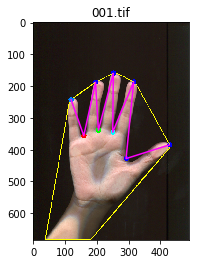

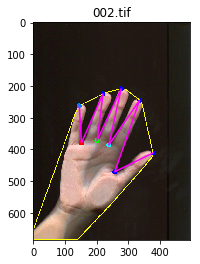

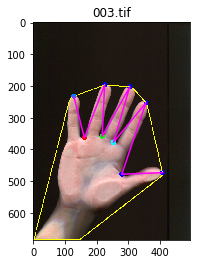

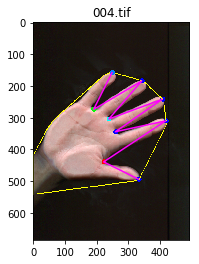

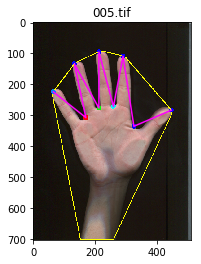

...

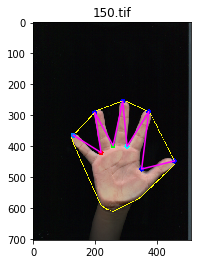

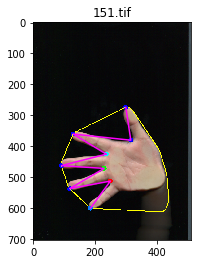

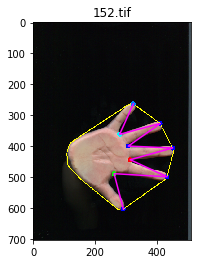

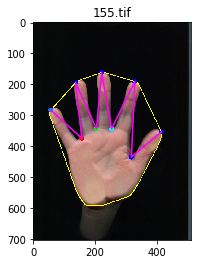

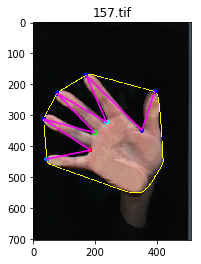

In [7]:
#import os #091
database = {}
square = {}
color = {}
perim  = {}
fin_cent = {}
betw_cent = {}
betw_betw = {}

#pict_lst = os.listdir('training')
for i, pict in enumerate(pict_lst[:len(pict_lst) - 1]): #50, 82, 90, 95, 141
    image = cv2.imread(os.path.join('training', pict))
    f,p,_,_,sq, av_color, perimeter = detect_fingers_final(image, title=pict)
    if not(len(f) == 5 and len(p) == 4):
        f,p,_,_,sq, av_color, perimeter = detect_fingers_final(image, title=pict, bad_pict=True)
    fing, betw, last = draw_cont(f,p, image, title=pict)
    database[pict] = []
    database[pict].append(dist(last, betw[0]))
    for j in range(0, 3):
        database[pict].append(dist(fing[j], betw[j]))
        database[pict].append(dist(fing[j], betw[j + 1]))
    database[pict].append(dist(fing[3], betw[3]))
    
    fin_cent[pict] = []
    fin_cent[pict].append(dist(all_cent[i], last))
    for j in range(0, 4):
        fin_cent[pict].append(dist(all_cent[i], fing[j]))
        
    betw_cent[pict] = []
    for j in range(0, 4):
        betw_cent[pict].append(dist(betw[j], all_cent[i]))
        
    betw_betw[pict] = []
    for j in range(0, 3):
        betw_betw[pict].append(dist(betw[j], betw[j + 1]))
    
    square[pict] = sq
    color[pict] = av_color
    perim[pict] = perimeter

### Подсчет матрицы попарных расстояний

In [8]:
def euclidean_distance(X, Y): #подсчет матрицы попарных расстояний
    X_sum = np.sum(X * X, axis=1)
    Y_sum = np.sum(Y * Y, axis=1)
    XY_sum = np.dot(X, Y.T)

    X_new = np.tile(X_sum[:, np.newaxis], (1, Y.shape[0]))
    Y_new = np.tile(Y_sum[:, np.newaxis], (1, X.shape[0])).T
    
    return (X_new - 2 * XY_sum + Y_new) ** 0.5

### Запись всех полученных признаков в матрицу

In [9]:
#CREATE MATRIX WITH ALL FEATURES
num = {}
rev = {}
i = 0

matr = np.zeros((99, 23))
#first - main vector length - database
for key in database: #0 - 7
    num[key] = i
    rev[i] = key
    matr[i, :8] = np.array(database[key])
    i += 1
i = 0  
#second - new features: from center to fingers - fin_cent
for key in fin_cent: #8 - 12
    matr[i, 8:13] = np.array(fin_cent[key])
    i += 1
i = 0
#third - new features: from center to betws - betw_cent   
for key in betw_cent: #13 - 16
    matr[i, 13:17] = np.array(betw_cent[key])
    i += 1
i = 0
#forth- new features: from betws to betws - betw_betw
for key in betw_betw: #17 - 21
    matr[i, 17:20] = np.array(betw_betw[key])
    i += 1
i = 0   
#fifth - square
for key in square: #21
    matr[i, 20] = square[key]
    i += 1
i = 0
#sixth - perim
for key in perim: #22
    matr[i, 21] = perim[key]
    i += 1
i = 0    
#seventh - color
for key in color: #23
    matr[i, 22] = color[key]
    i += 1

### Поиск ближайших соседей

In [10]:
def count_euclidean(matr, idx=np.arange(0, 23), norm=False):
    matr = matr[:,idx]
    if norm:
        matr = (matr - np.mean(matr, axis=0)) / np.std(matr, axis=0)
        
    dist_1 = euclidean_distance(matr, matr)
    for j in range(99):
        dist_1[j, j] = 1000000
    
    dist_3 = np.argsort(dist_1, axis=1)[:,:3]
    
    return dist_1, dist_3

### Визуализация

In [11]:
def off_ticks(axes):
    axes.set_xticks([])
    axes.set_yticks([])
    
def find(pict, num, rev):
    gridsize = (1, 4)
    fig = plt.figure(figsize=(15, 4))
    ax1 = plt.subplot2grid(gridsize, (0, 0))
    ax2 = plt.subplot2grid(gridsize, (0, 1))
    ax3 = plt.subplot2grid(gridsize, (0, 2))
    ax4 = plt.subplot2grid(gridsize, (0, 3))
    off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4)
    
    p1 = rev[dist_3[num[pict]][0]]
    p2 = rev[dist_3[num[pict]][1]]
    p3 = rev[dist_3[num[pict]][2]]
    
    d1 = dist_1[num[pict], dist_3[num[pict]][0]]
    d2 = dist_1[num[pict], dist_3[num[pict]][1]]
    d3 = dist_1[num[pict], dist_3[num[pict]][2]]
    
    ax1.imshow(cv2.imread(os.path.join('training', pict))[:,:,[2,1,0]])
    ax1.set_title(f'Original: {pict}')
    ax2.imshow(cv2.imread(os.path.join('training', p1))[:,:,[2,1,0]])
    ax2.set_title(f'Neigh_1: {p1}, dist: {d1:.3f}')
    ax3.imshow(cv2.imread(os.path.join('training', p2))[:,:,[2,1,0]])
    ax3.set_title(f'Neigh_2: {p2}, dist: {d2:.3f}')
    ax4.imshow(cv2.imread(os.path.join('training', p3))[:,:,[2,1,0]])
    ax4.set_title(f'Neigh_3: {p3}, dist: {d3:.3f}')

### Лучший вариант: 8 + 5 линий + площадь, периметр, цвет

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in sqrt
  if __name__ == '__main__':


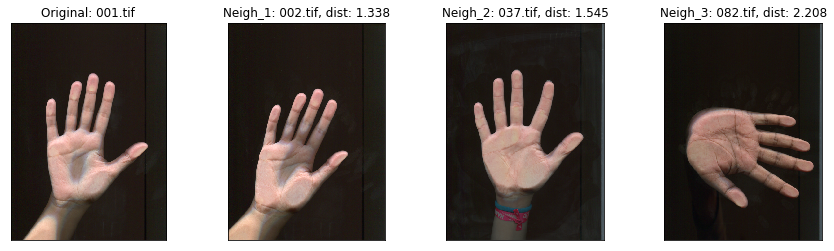

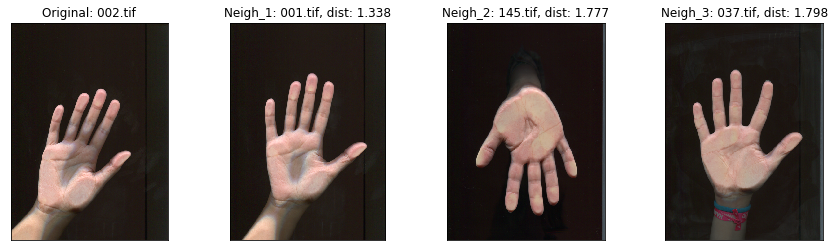

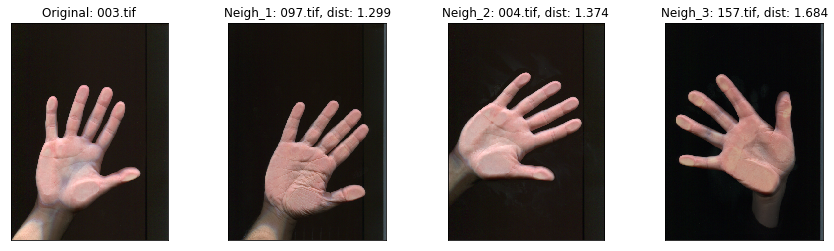

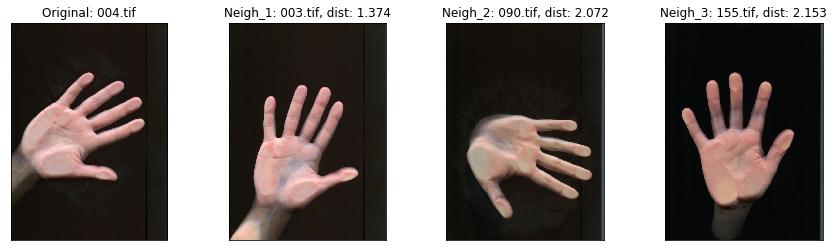

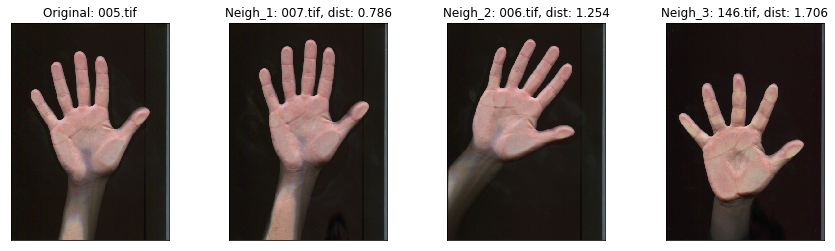

...

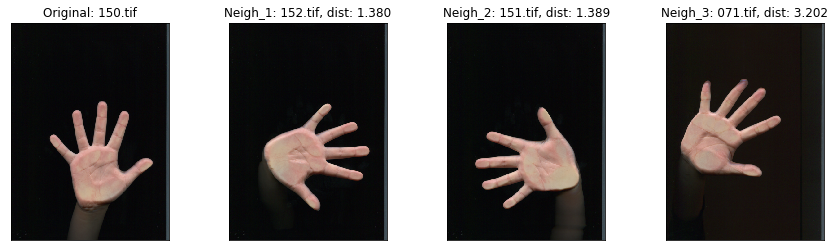

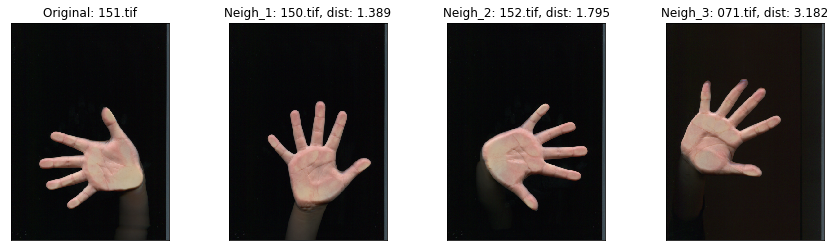

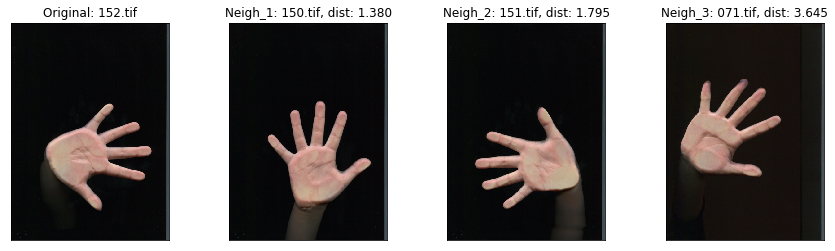

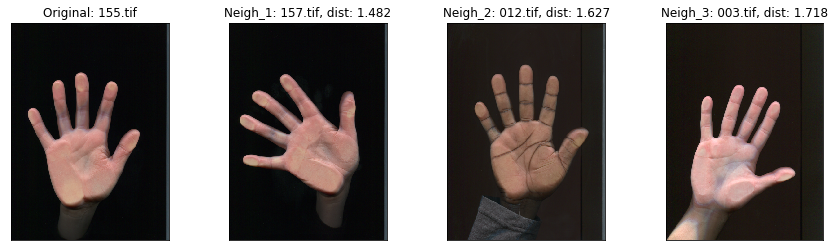

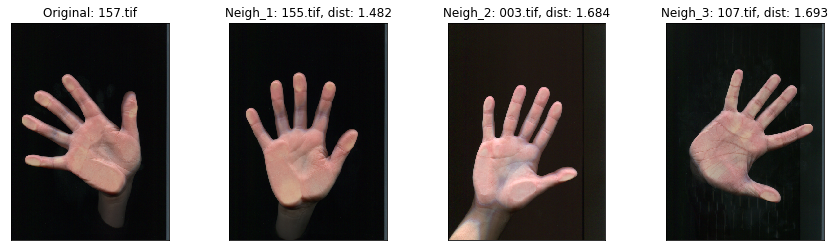

In [12]:
idx = [0,1,2,3,4,5,6,7,8,9,10,11,12,20,21,22] #очень хороший вариант
dist_1, dist_3 = count_euclidean(matr, idx, True)
for pict in pict_lst[:len(pict_lst) - 1]:
    find(pict, num, rev)

### Запись информации о соседях в таблицу

In [13]:
idx = [0,1,2,3,4,5,6,7,8,9,10,11,12,20,21,22] #очень хороший вариант
dist_1, dist_3 = count_euclidean(matr, idx, True)

dict_for_csv = {}
for i, pict in enumerate(pict_lst[:len(pict_lst) - 1]):
    p1 = rev[dist_3[num[pict]][0]]
    p2 = rev[dist_3[num[pict]][1]]
    p3 = rev[dist_3[num[pict]][2]]
    
    dict_for_csv[i] = []
    
    dict_for_csv[i].append(pict)
    dict_for_csv[i].append(p1)
    dict_for_csv[i].append(p2)
    dict_for_csv[i].append(p3)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in sqrt
  if __name__ == '__main__':


In [56]:
alpha = pd.DataFrame.from_dict(dict_for_csv)
alpha = alpha.T
alpha.rename(columns={0: 'Picture', 1: 'First_neigh', 2: 'Second_neigh', 3: 'Third_neigh'}, inplace=True)
alpha.to_csv('neighbours.csv', index=False)
a = pd.read_csv('neighbours.csv')
a.head(3)

,Picture,First_neigh,Second_neigh,Third_neigh
0,001.tif,002.tif,037.tif,082.tif
1,002.tif,001.tif,145.tif,037.tif
2,003.tif,097.tif,004.tif,157.tif


### Кластеризация с записью в таблицу

In [14]:
idx = [0,1,2,3,4,5,6,7,8,9,10,11,12, 20,21,22]
for_neigh = matr[:, idx]
for_neigh = (for_neigh - np.mean(for_neigh, axis=0)) / np.std(for_neigh, axis=0)

In [17]:
model = OPTICS(min_samples = 2, metric = 'euclidean').fit(for_neigh)
labels = model.labels_
print(labels, np.unique(labels).shape[0])

[ 0  0  2  2  1  1  1 -1 -1 -1 13  4  4  5  5 -1 -1  6  6 13  6 17 -1 12
 19 -1 19 19 -1 18 19 -1 -1 -1 -1 -1 -1 -1 -1  8  8  9  9  9  6 10 -1 -1
 -1 -1 14 -1 -1 20 12 10 12 12 11 11  6  7 -1  7 16 18 -1 18  2 -1 -1 -1
 -1 -1 -1 16 16 16 -1 -1 15 15 17 17 -1 14 14 -1 -1 -1 -1 -1 -1 -1 20 20
 20  3  3] 22


In [18]:
from sklearn.cluster import KMeans

model = KMeans(n_clusters=22)
model.fit(for_neigh)
predicted_label = model.predict(for_neigh)

print(predicted_label) # нормальная кластеризация

[12 12  5 15  5  5  5  2 21 10  7 15 15 15 15 10 18 18 18  7 18  6  6 10
 13 13 13 13 10  4  6 13 12 12  8  2 14 14  8 16 16 16 16 16 18  2 14 21
 21  7  7  0 18  3 18  2 18 18  2  2 18  1  2  1  9  4 20  4  5  5 11 11
 11  0 19  9  9  9 20 17 20 20  6  4 20  7  7  8  7 21  1  5  8  5  3  3
  3 15 15]


In [201]:
# На случай если верхняя клеточка испортится
# predicted_label = np.array([16,  3, 20, 20, 17, 17, 17,  4, 13,  0, 11, 21, 21, 21, 21,  0,  0,
#         6,  8, 11,  8,  9,  9,  6, 14, 14, 14, 14, 13,  5,  9, 14, 16, 16,
#        19,  4, 15, 15, 19, 12, 12, 12, 12, 12,  8,  4,  3, 13, 13, 10, 11,
#        11,  6,  2,  6,  4,  6,  6,  4,  4,  8,  8,  4,  8,  7,  5,  7,  5,
#        17, 20, 18, 18, 18,  1, 1,  7,  7,  7,  1, 0,  1,  7,  9,  5,  1,
#        11, 11, 20, 10, 13,  8,  3, 19,  3,  2,  2,  2, 20, 20])

In [207]:
dict_for_cluster = {}
for label in np.unique(predicted_label):
    dict_for_cluster[label] = list(np.zeros(10))
    idx = np.where(predicted_label == label)
    j = 0
    for i in list(idx[0]):
        dict_for_cluster[label][j] = rev[i]
        j += 1

In [226]:
beta = pd.DataFrame.from_dict(dict_for_cluster)
beta.rename(columns={i: 'Cluster # ' + str(i) for i in range(22)}, inplace=True)
beta = beta.T
beta.to_csv('clusters.csv', index=True)
b = pd.read_csv('clusters.csv')
b.head(3)

,Unnamed: 0,0,1,2,3,4,5,6,7,8,9
0,Cluster # 0,010.tif,016.tif,017.tif,120.tif,0.0,0.0,0.0,0.0,0.0,0.0
1,Cluster # 1,109.tif,111.tif,118.tif,122.tif,127.tif,0.0,0.0,0.0,0.0,0.0
2,Cluster # 2,071.tif,150.tif,151.tif,152.tif,0.0,0.0,0.0,0.0,0.0,0.0


In [20]:
b = pd.read_csv('clusters.csv')
b

,Unnamed: 0,0,1,2,3,4,5,6,7,8,9
0,Cluster # 0,010.tif,016.tif,017.tif,120.tif,0.0,0.0,0.0,0.0,0.0,0.0
1,Cluster # 1,109.tif,111.tif,118.tif,122.tif,127.tif,0.0,0.0,0.0,0.0,0.0
2,Cluster # 2,071.tif,150.tif,151.tif,152.tif,0.0,0.0,0.0,0.0,0.0,0.0
3,Cluster # 3,002.tif,060.tif,144.tif,146.tif,0.0,0.0,0.0,0.0,0.0,0.0
4,Cluster # 4,008.tif,046.tif,057.tif,077.tif,081.tif,082.tif,090.tif,0.0,0.0,0.0
5,Cluster # 5,034.tif,093.tif,096.tif,126.tif,0.0,0.0,0.0,0.0,0.0,0.0
6,Cluster # 6,018.tif,024.tif,068.tif,076.tif,078.tif,079.tif,0.0,0.0,0.0,0.0
7,Cluster # 7,092.tif,095.tif,112.tif,113.tif,114.tif,123.tif,0.0,0.0,0.0,0.0
8,Cluster # 8,019.tif,021.tif,056.tif,086.tif,088.tif,091.tif,142.tif,0.0,0.0,0.0
9,Cluster # 9,022.tif,023.tif,035.tif,124.tif,0.0,0.0,0.0,0.0,0.0,0.0


### Сохранение некоторых изображений для отчета

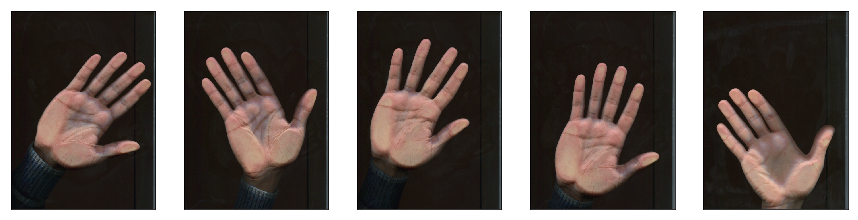

In [154]:
gridsize = (1, 5)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))
ax5 = plt.subplot2grid(gridsize, (0, 4))
off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4), off_ticks(ax5)

ax1.imshow(cv2.imread(os.path.join('training', rev[24]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[25]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[26]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[27]))[:,:,[2,1,0]])
ax5.imshow(cv2.imread(os.path.join('training', rev[31]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_1.png')

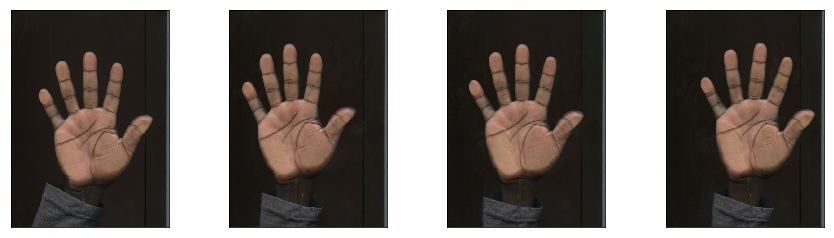

In [155]:
gridsize = (1, 4)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))
off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4)

ax1.imshow(cv2.imread(os.path.join('training', rev[11]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[12]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[13]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[14]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_2.png')

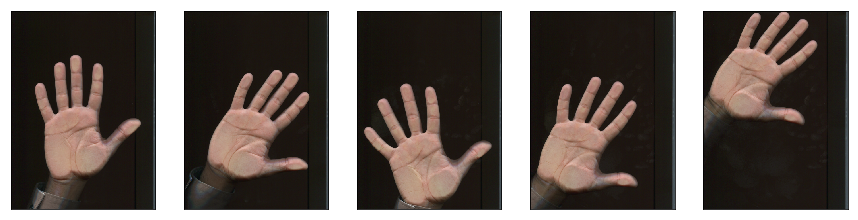

In [153]:
gridsize = (1, 5)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))
ax5 = plt.subplot2grid(gridsize, (0, 4))
off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4), off_ticks(ax5)

ax1.imshow(cv2.imread(os.path.join('training', rev[39]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[40]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[41]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[42]))[:,:,[2,1,0]])
ax5.imshow(cv2.imread(os.path.join('training', rev[43]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_3.png')

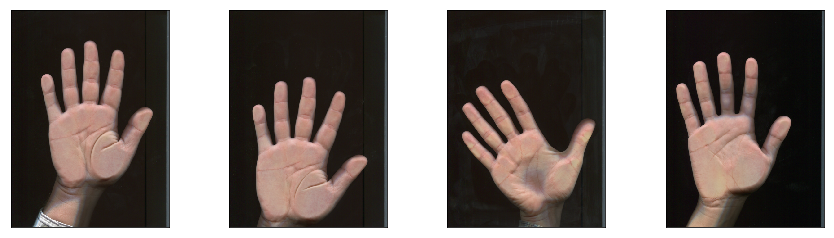

In [158]:
gridsize = (1, 4)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))
off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4)

ax1.imshow(cv2.imread(os.path.join('training', rev[21]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[22]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[30]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[82]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_4.png')

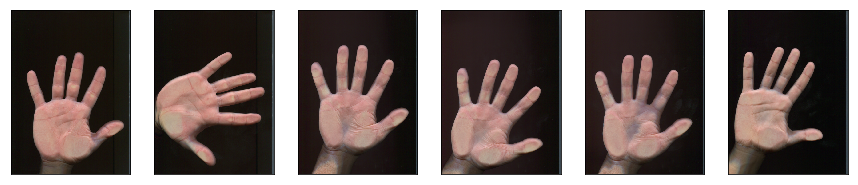

In [161]:
gridsize = (1, 6)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))
ax5 = plt.subplot2grid(gridsize, (0, 4))
ax6 = plt.subplot2grid(gridsize, (0, 5))

off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4), off_ticks(ax5), off_ticks(ax6)

ax1.imshow(cv2.imread(os.path.join('training', rev[64]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[66]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[75]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[76]))[:,:,[2,1,0]])
ax5.imshow(cv2.imread(os.path.join('training', rev[77]))[:,:,[2,1,0]])
ax6.imshow(cv2.imread(os.path.join('training', rev[81]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_5.png')

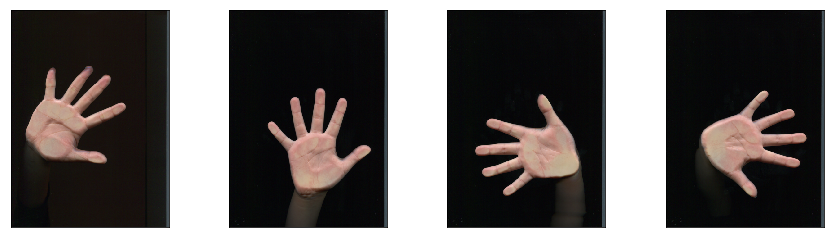

In [189]:
gridsize = (1, 4)
fig = plt.figure(figsize=(15, 4))
ax1 = plt.subplot2grid(gridsize, (0, 0))
ax2 = plt.subplot2grid(gridsize, (0, 1))
ax3 = plt.subplot2grid(gridsize, (0, 2))
ax4 = plt.subplot2grid(gridsize, (0, 3))

off_ticks(ax1), off_ticks(ax2), off_ticks(ax3), off_ticks(ax4)

ax1.imshow(cv2.imread(os.path.join('training', rev[53]))[:,:,[2,1,0]])
ax2.imshow(cv2.imread(os.path.join('training', rev[94]))[:,:,[2,1,0]])
ax3.imshow(cv2.imread(os.path.join('training', rev[95]))[:,:,[2,1,0]])
ax4.imshow(cv2.imread(os.path.join('training', rev[96]))[:,:,[2,1,0]])

plt.savefig('cluster_ex_6.png')

### Попытка повторного применения OPTICS

In [63]:
new_neigh = np.zeros(((np.sum(labels == -1)), 16))
j = 0
for i in range(99):
    if labels[i] == -1:
        new_neigh[j] = for_neigh[i]
        j += 1

In [66]:
model = OPTICS(min_samples = 2, metric = 'euclidean', cluster_method = 'xi', xi = 0.001).fit(new_neigh)

labels_1 = model.labels_
print(labels_1, np.unique(labels_1).shape[0])

[-1  0 -1  1  1 -1 -1 -1  5 -1  5  5  0  0  2  4 -1  3 -1 -1  3  3  3  4
 -1 -1 -1 -1 -1  2  0  3  5] 7


### Кластеризация методом AffinityPropagation

In [132]:
from sklearn.cluster import AffinityPropagation
import numpy as np

clustering = AffinityPropagation(damping=0.85).fit(for_neigh)

c = clustering.labels_ #num_classes = 12
c

array([ 5,  5,  0,  0, 10,  6,  0,  2,  2,  4,  1, 10, 10, 10, 10,  2,  2,
        2,  6,  1,  2,  9,  9,  2,  3,  3,  3,  3,  4,  9,  9,  3,  5,  5,
        5,  2, 10, 10, 10,  6,  6,  6,  6,  6,  6,  2, 10,  4,  2,  1,  1,
        8,  1, 11,  2,  2,  2,  2,  6,  2,  6,  6,  0,  6,  7,  9,  8,  9,
        0,  0,  0,  6,  0,  8,  4,  7,  7,  7,  8,  9,  8,  8,  9,  9,  8,
        6,  6,  0,  1,  2,  6, 10,  5, 10, 11, 11, 11,  0,  0],
      dtype=int64)